In [1]:
import numpy as np
import nat_asd_utils

import matplotlib.pyplot as plt
import seaborn as sns

import nilearn.plotting as plotting
import hcp_utils as hcp

import glob
import pandas as pd

from scipy.stats import false_discovery_control

import nibabel as nb


pixdim[1,2,3] should be non-zero; setting 0 dims to 1


In [13]:
#np.load(f'../pilot_results/feat-audio_sub-{sub}_ROI-all_PCA-{n_components}_delay-{delay}', r2s=r2s, stacked_r2s=stacked_r2s, r2s_weighted=r2s_weighted, S_average=S_average, elapsed_time=elapsed_time)

In [14]:
# def load_glasser():
#     #atlas_dlabel='/om2/user/jsmentch/atlases/atlas-Glasser/atlas-Glasser_space-fsLR_den-91k_dseg.dlabel.nii'
#     atlas_dlabel='/Users/jeff/Downloads/nat_asd_temp/tpl-fsLR_atlas-Glasser_den-32k_dseg.dlabel.nii'
#     img = nb.load(atlas_dlabel)
#     atlas_data=img.get_fdata()
#     atlas_data=atlas_data[0,:]
#     #atlas=pd.read_csv('/om2/user/jsmentch/atlases/atlas-Glasser/atlas-Glasser_dseg.tsv', sep='\t')
#     atlas=pd.read_csv('/Users/jeff/Downloads/nat_asd_temp/atlas-Glasser_dseg.tsv', sep='\t')
#     return(atlas,atlas_data)

In [15]:
#r2s, stacked_r2s, r2s_weighted, S_average, elapsed_time = np.load('../pilot_results/feat-audio_sub-NDARUX340FYC_ROI-all_PCA-20_delay-6.npz')

In [2]:
#data=np.load('../pilot_results/feat-audio_sub-NDARUX340FYC_ROI-all_PCA-20_delay-6.npz')
temp_dir='../pilot_results/'
data=np.load(f'{temp_dir}feat-audio_sub-NDARUL694GYN_ROI-all_PCA-20_delay-6.npz')
#keys r2s, stacked_r2s, r2s_weighted, S_average, elapsed_time

In [3]:
data['stacked_r2s'].shape

(12685,)

In [5]:
atlas,atlas_data=nat_asd_utils.load_glasser()


parcels=[
    'V1',
    'V2',
    'V3',
    'V4',
    'MT',
    'MST',
    'V4t',
    'FST',
    'FFC',
    'V8',
    'PIT',
    'VVC',
    'VMV1',
    'VMV2',
    'VMV3',
    'V3A',
    'V3B',
    'V6',
    'V6A',
    'V7',
    'IPS1',
    'IFSa',
    'IFSp',
    'IFJa',
    'IFJp',
    'FEF',
    'STSvp',
    'STSdp',
    'STSva',
    'STSda',
    'STGa',
    'STV',
    'TPOJ1',
    'TPOJ2',
    'TPOJ3',
    'A1',
    'LBelt',
    'MBelt',
    'PBelt',
    'A4',
    'TA2',
    'A5']

atlas_indices,indices,parcel_names=nat_asd_utils.get_parcel_indices(atlas,parcels)


atlas_indices_indices = np.where(np.isin(atlas_data, atlas_indices))[0]


In [6]:
plot_brain=np.zeros(atlas_data.shape)
for i, ind in enumerate(atlas_indices_indices):
    plot_brain[ind]=data['stacked_r2s'][i]

plotting.view_surf(hcp.mesh.inflated, hcp.cortex_data(plot_brain), 
    threshold=0.001,bg_map=hcp.mesh.sulc)

## pull out a specific ROI from this

In [7]:
def get_data_by_roi(parcels,data,metric):
    roi_data_all=[]
    
    # put the grayordinates back where they belong
    all_brain=np.zeros(atlas_data.shape)
    
    for i, ind in enumerate(atlas_indices_indices):
        all_brain[ind]=data[metric][i]
        
    all_brain.shape
    for parcel in parcels:
        #parcel=['A1']
        roi_indices,indices_,roi_names=nat_asd_utils.get_parcel_indices(atlas,[parcel])
        roi_indices_indices = np.where(np.isin(atlas_data, roi_indices))[0]
        
        
        plot_roi=np.zeros(atlas_data.shape)
        for i, roi_ind in enumerate(roi_indices_indices):
            plot_roi[roi_ind]=all_brain[roi_ind]
        roi_data=plot_roi[roi_indices_indices]
        roi_data.shape
        roi_data_all.append(roi_data)
    return(roi_data_all)

In [8]:
roi_data_all=get_data_by_roi(parcels,data,'stacked_r2s')

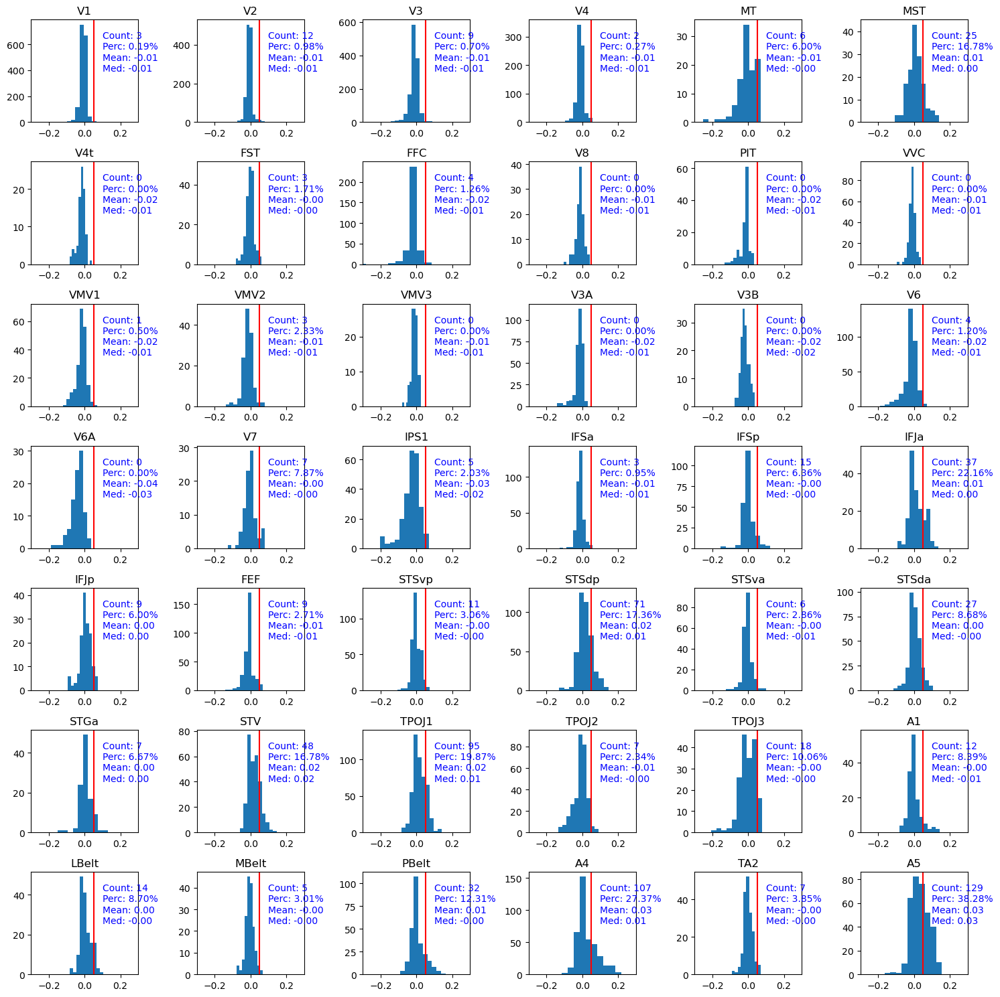

In [9]:
# Determine the number of rows and columns for the subplots
thresh=0.05

num_plots = len(roi_data_all)
num_cols = int(num_plots**0.5)
num_rows = num_plots // num_cols + (num_plots % num_cols > 0)

fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 15))  # Adjust the size as needed

# Flatten the axes array if there's more than one row and column
if num_rows > 1 and num_cols > 1:
    axs = axs.flatten()

for i, d in enumerate(roi_data_all):
    parcel_name = parcels[i]
    ax = axs[i]
    ax.hist(d)  # Adjust the histogram parameters as needed
    ax.set_title(parcel_name)
    ax.set_xlim(-0.3, 0.3)  # Set x-axis limits

    # Add a vertical line at x=0.1
    ax.axvline(x=thresh, color='red')

    # Calculate the percentage of values greater than 0.1
    count = np.sum(np.array(d) > thresh)
    percentage = (count / len(d)) * 100
    mean=np.mean(np.array(d))
    median=np.median(np.array(d))

    # Display the count and percentage on the plot
    ax.text(0.1, ax.get_ylim()[1] / 2, f'Count: {count}\nPerc: {percentage:.2f}%\nMean: {mean:.2f}\nMed: {median:.2f}', color='blue', ha='left')

plt.tight_layout()
plt.show()

## plot a specific ROI

In [10]:
# put the grayordinates back where they belong
parcel=['A4']
#parcel=parcels

all_brain=np.zeros(atlas_data.shape)

for i, ind in enumerate(atlas_indices_indices):
    all_brain[ind]=data['stacked_r2s'][i]
    
roi_indices,indices_,roi_names=nat_asd_utils.get_parcel_indices(atlas,parcel) #get indices of V1
roi_indices_indices = np.where(np.isin(atlas_data, roi_indices))[0]


plot_roi=np.zeros(atlas_data.shape)
for i, roi_ind in enumerate(roi_indices_indices):
    plot_roi[roi_ind]=all_brain[roi_ind]
roi_data=plot_roi[roi_indices_indices]

plotting.view_surf(hcp.mesh.inflated, hcp.cortex_data(plot_roi), 
    threshold=0.001,bg_map=hcp.mesh.sulc)

In [11]:
# put the grayordinates back where they belong
#parcel=['A4']

data_to_plot=np.argmax(data['S_average'],axis=1)


parcel=parcels

all_brain=np.zeros(atlas_data.shape)

for i, ind in enumerate(atlas_indices_indices):
    all_brain[ind]=data_to_plot[i]
    
roi_indices,indices_,roi_names=nat_asd_utils.get_parcel_indices(atlas,parcel) #get indices of V1
roi_indices_indices = np.where(np.isin(atlas_data, roi_indices))[0]


plot_roi=np.zeros(atlas_data.shape)
for i, roi_ind in enumerate(roi_indices_indices):
    plot_roi[roi_ind]=all_brain[roi_ind]
roi_data=plot_roi[roi_indices_indices]

plotting.view_surf(hcp.mesh.inflated, hcp.cortex_data(plot_roi), 
    threshold=0.001,bg_map=hcp.mesh.sulc)

## plot best layer across all of the subjects (or any ROI)

In [12]:
feat='audio'
ROI='all'
PCA='200'
delay='6'


# Assuming feat, ROI, PCA, delay are defined
all_data=[]
files = glob.glob(f'../pilot_results/feat-{feat}_sub-*_ROI-{ROI}_PCA-{PCA}_delay-{delay}.npz')
for f in files:
    data=np.load(f)
    all_data.append(data['S_average'])
all_data=np.mean( np.asanyarray(all_data), axis=0)

# put the grayordinates back where they belong
#parcel=['A4']

data_to_plot=np.argmax(all_data,axis=1)


parcel=parcels

all_brain=np.zeros(atlas_data.shape)

for i, ind in enumerate(atlas_indices_indices):
    all_brain[ind]=data_to_plot[i]
    
roi_indices,indices_,roi_names=nat_asd_utils.get_parcel_indices(atlas,parcel) #get indices of V1
roi_indices_indices = np.where(np.isin(atlas_data, roi_indices))[0]


plot_roi=np.zeros(atlas_data.shape)
for i, roi_ind in enumerate(roi_indices_indices):
    plot_roi[roi_ind]=all_brain[roi_ind]
roi_data=plot_roi[roi_indices_indices]

plotting.view_surf(hcp.mesh.inflated, hcp.cortex_data(plot_roi), 
    threshold=0.001,bg_map=hcp.mesh.sulc)

In [13]:
feat='audio'
ROI='all'
PCA='1'
delay='6'
all_data=[]
files = glob.glob(f'../pilot_results/feat-{feat}_sub-*_ROI-{ROI}_PCA-{PCA}_delay-{delay}.npz')
for f in files:
    data=np.load(f)
    all_data.append(data['stacked_r2s'])
all_data=np.mean( np.asanyarray(all_data), axis=0)
data_to_plot=all_data
parcel=parcels
all_brain=np.zeros(atlas_data.shape)
for i, ind in enumerate(atlas_indices_indices):
    all_brain[ind]=data_to_plot[i]
roi_indices,indices_,roi_names=nat_asd_utils.get_parcel_indices(atlas,parcel) #get indices of V1
roi_indices_indices = np.where(np.isin(atlas_data, roi_indices))[0]
plot_roi=np.zeros(atlas_data.shape)
for i, roi_ind in enumerate(roi_indices_indices):
    plot_roi[roi_ind]=all_brain[roi_ind]
roi_data=plot_roi[roi_indices_indices]
plotting.view_surf(hcp.mesh.inflated, hcp.cortex_data(plot_roi), 
    threshold=0.001,bg_map=hcp.mesh.sulc)

In [14]:
files

['../pilot_results/feat-audio_sub-NDARDU853XZ6_ROI-all_PCA-1_delay-6.npz',
 '../pilot_results/feat-audio_sub-NDAREM731BYM_ROI-all_PCA-1_delay-6.npz',
 '../pilot_results/feat-audio_sub-NDARFA402LMW_ROI-all_PCA-1_delay-6.npz',
 '../pilot_results/feat-audio_sub-NDARHJ034LDM_ROI-all_PCA-1_delay-6.npz',
 '../pilot_results/feat-audio_sub-NDARHJ830RXD_ROI-all_PCA-1_delay-6.npz',
 '../pilot_results/feat-audio_sub-NDARJG687YYX_ROI-all_PCA-1_delay-6.npz',
 '../pilot_results/feat-audio_sub-NDARJM828PAL_ROI-all_PCA-1_delay-6.npz',
 '../pilot_results/feat-audio_sub-NDARJZ679KXJ_ROI-all_PCA-1_delay-6.npz',
 '../pilot_results/feat-audio_sub-NDARLA226ADX_ROI-all_PCA-1_delay-6.npz',
 '../pilot_results/feat-audio_sub-NDARLV252DY2_ROI-all_PCA-1_delay-6.npz',
 '../pilot_results/feat-audio_sub-NDARNP423EJQ_ROI-all_PCA-1_delay-6.npz',
 '../pilot_results/feat-audio_sub-NDARPV009TYX_ROI-all_PCA-1_delay-6.npz',
 '../pilot_results/feat-audio_sub-NDARRB359CRR_ROI-all_PCA-1_delay-6.npz',
 '../pilot_results/feat-a

## plot the auditory regions by subject

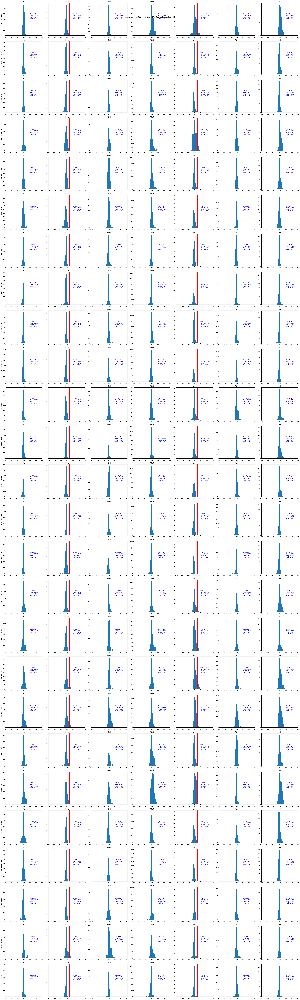

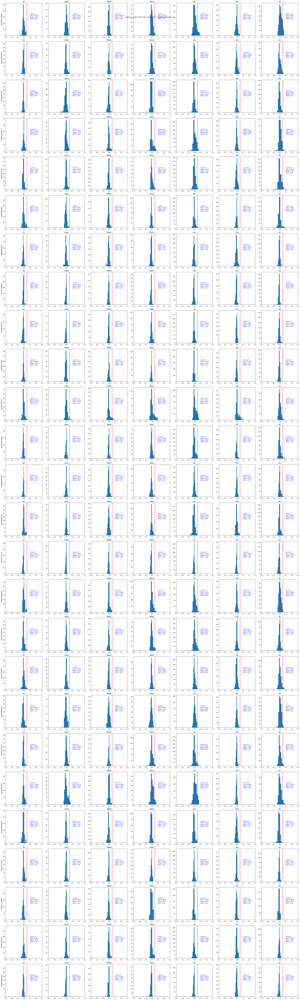

In [19]:
for delay in ['5','7']:
    
    parcels=['A1',
        'LBelt',
        'MBelt',
        'PBelt',
        'A4',
        'TA2',
        'A5']
    
    feat='audio'
    ROI='all'
    PCA='200'
    #delay='6'
    all_data=[]
    
    metric='stacked_r2s'
    temp_dir='../pilot_results/'
    
    files = glob.glob(f'{temp_dir}feat-{feat}_sub-*_ROI-{ROI}_PCA-{PCA}_delay-{delay}.npz')
    subs = []
    for path in files:
        start = path.find('sub-') + 4  # add 4 to exclude 'sub-' itself
        end = path.find('_ROI')
        isolated_string = path[start:end]
        subs.append(isolated_string)
    
    # Determine the number of rows and columns for the subplots
    thresh=0.05
    
    #num_plots = len(roi_data_all)
    #num_cols = int(num_plots**0.5)
    num_cols=len(parcels)
    #num_rows = num_plots // num_cols + (num_plots % num_cols > 0)
    num_rows=len(files)
    
    fig, axs = plt.subplots(num_rows, num_cols, figsize=(30,100))  # Adjust the size as needed
    fig.suptitle(f'feature: {feat}, PCA: {PCA}, delay TRs: {delay}, metric: {metric}')
    
    # Flatten the axes array if there's more than one row and column
    if num_rows > 1 and num_cols > 1:
        axs = axs.flatten()
    
    for i, f in enumerate(files):
        data=np.load(f)
        roi_data_all=get_data_by_roi(parcels,data,metric)
        axs[(i-1)*num_cols].set_ylabel(f'{subs[i]}')
        for ii, d in enumerate(roi_data_all):
            parcel_name = parcels[ii]
            ax = axs[(i-1)*num_cols+ii]
            ax.hist(d)  # Adjust the histogram parameters as needed
            ax.set_title(parcel_name)
            ax.set_xlim(-0.3, 0.3)  # Set x-axis limits
        
            # Add a vertical line at x=0.1
            ax.axvline(x=thresh, color='red')
        
            # Calculate the percentage of values greater than 0.1
            count = np.sum(np.array(d) > thresh)
            percentage = (count / len(d)) * 100
            mean=np.mean(np.array(d))
            median=np.median(np.array(d))
        
            # Display the count and percentage on the plot
            ax.text(0.1, ax.get_ylim()[1] / 2, f'Count: {count}\nPerc: {percentage:.2f}%\nMean: {mean:.2f}\nMed: {median:.2f}', color='blue', ha='left')
    
    plt.tight_layout()
    plt.show()
#    fig.savefig(f'../plots/histogram_feat-{feat}_PCA-{PCA}_delay-{delay}_metric-{metric}.png')


## a plot where there is a line for each subject and it shows the performance of number of PCA dimensions for the auditory regions

In [20]:
parcels=['A1',
    'LBelt',
    'MBelt',
    'PBelt',
    'A4',
    'TA2',
    'A5']

feat='audio'
ROI='all'
PCA='1'
delay='6'
all_data=[]

metric='stacked_r2s'
temp_dir='../pilot_results/'

files = glob.glob(f'{temp_dir}feat-{feat}_sub-*_ROI-{ROI}_PCA-{PCA}_delay-{delay}.npz')
subs = []
for path in files:
    start = path.find('sub-') + 4  # add 4 to exclude 'sub-' itself
    end = path.find('_ROI')
    isolated_string = path[start:end]
    subs.append(isolated_string)

In [21]:
mean_r2=[]
for sub in subs:
    #sub=subs[0]
    mean_r2_sub=[]
    for PCA in ['1','20','50','200']:
        
        mean_r2_PCA=[]
        
        f=f'{temp_dir}feat-{feat}_sub-{sub}_ROI-{ROI}_PCA-{PCA}_delay-{delay}.npz'
        data=np.load(f)
        roi_data_all=get_data_by_roi(parcels,data,metric)
        for r in roi_data_all:
            mean_r2_PCA.append(np.mean(r))
        mean_r2_sub.append(mean_r2_PCA)
    mean_r2.append(mean_r2_sub)

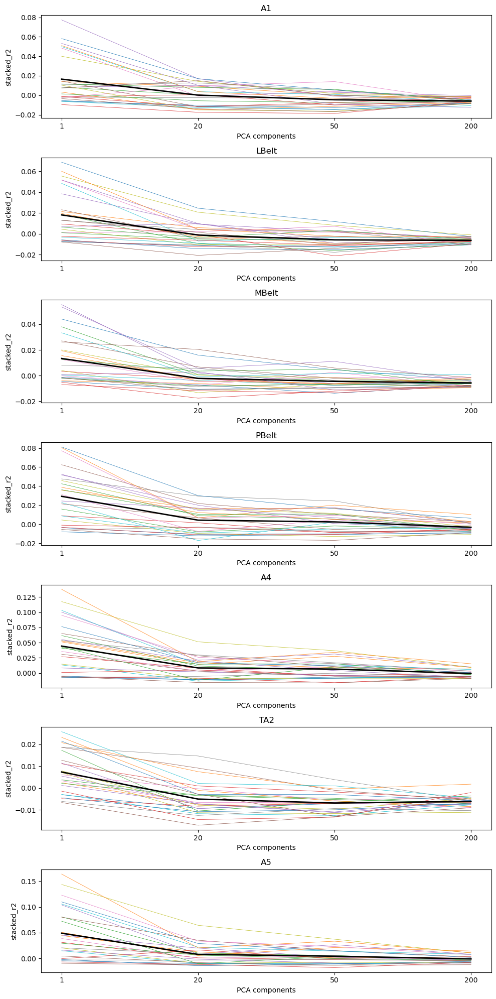

In [22]:
data = np.asanyarray(mean_r2)

fig, axs = plt.subplots(7, figsize=(10, 20))

x_ticks = [1, 20, 50, 200]

for i,parcel in enumerate(parcels):  # Loop over parcels
    for j,sub in enumerate(subs):  # Loop over subjects
        axs[i].plot(data[j, :, i], label=f'{sub}', linewidth=0.5)
    axs[i].plot( np.mean(data,axis=0)[:,i], label='mean', linewidth=2, color='k' )
    axs[i].set_title(f'{parcel}')
    axs[i].set_xticks(range(4))  # Set x-axis ticks
    axs[i].set_xticklabels(x_ticks)  # Rename x-axis ticks
    axs[i].set_xlabel('PCA components')  # Label x-axis
    axs[i].set_ylabel('stacked_r2')  # Label y-axis
plt.tight_layout()
plt.show()
#fig.savefig(f'../plots/line_feat-{feat}_PCA-variable_delay-{delay}_metric-{metric}.png')

## plot PCA 200 over 3 delays

In [ ]:
parcels=['A1',
    'LBelt',
    'MBelt',
    'PBelt',
    'A4',
    'TA2',
    'A5']

feat='audio'
ROI='all'
PCA='200'
delay='6'
all_data=[]

metric='stacked_r2s'
temp_dir='/Users/jeff/Downloads/nat_asd_temp/pilot_results/'

files = glob.glob(f'{temp_dir}feat-{feat}_sub-*_ROI-{ROI}_PCA-{PCA}_delay-{delay}.npz')
subs = []
for path in files:
    start = path.find('sub-') + 4  # add 4 to exclude 'sub-' itself
    end = path.find('_ROI')
    isolated_string = path[start:end]
    subs.append(isolated_string)


mean_r2=[]
for sub in subs:
    #sub=subs[0]
    mean_r2_sub=[]
    for delay in ['5','6','7']:
        
        mean_r2_PCA=[]
        
        f=f'{temp_dir}feat-{feat}_sub-{sub}_ROI-{ROI}_PCA-{PCA}_delay-{delay}.npz'
        data=np.load(f)
        roi_data_all=get_data_by_roi(parcels,data,metric)
        for r in roi_data_all:
            mean_r2_PCA.append(np.mean(r))
        mean_r2_sub.append(mean_r2_PCA)
    mean_r2.append(mean_r2_sub)

data = np.asanyarray(mean_r2)

fig, axs = plt.subplots(7, figsize=(10, 20))

x_ticks = [5,6,7]

for i,parcel in enumerate(parcels):  # Loop over parcels
    for j,sub in enumerate(subs):  # Loop over subjects
        axs[i].plot(data[j, :, i], label=f'{sub}', linewidth=0.5)
    axs[i].plot( np.mean(data,axis=0)[:,i], label='mean', linewidth=2, color='k' )

    
    axs[i].set_title(f'{parcel}')
    axs[i].set_xticks(range(3))  # Set x-axis ticks
    axs[i].set_xticklabels(x_ticks)  # Rename x-axis ticks
    axs[i].set_xlabel('delay (in 0.8s TRs)')  # Label x-axis
    axs[i].set_ylabel('stacked_r2')  # Label y-axis
plt.tight_layout()
plt.show()
fig.savefig(f'../plots/line_feat-{feat}_PCA-{PCA}_delay-variable_metric-{metric}.png')

## look into the bootstrapping for a good subject

In [206]:
sub='NDARRM073JKA'

parcels=[
    'V1',
    'V2',
    'V3',
    'V4',
    'MT',
    'MST',
    'V4t',
    'FST',
    'FFC',
    'V8',
    'PIT',
    'VVC',
    'VMV1',
    'VMV2',
    'VMV3',
    'V3A',
    'V3B',
    'V6',
    'V6A',
    'V7',
    'IPS1',
    'IFSa',
    'IFSp',
    'IFJa',
    'IFJp',
    'FEF',
    'STSvp',
    'STSdp',
    'STSva',
    'STSda',
    'STGa',
    'STV',
    'TPOJ1',
    'TPOJ2',
    'TPOJ3',
    'A1',
    'LBelt',
    'MBelt',
    'PBelt',
    'A4',
    'TA2',
    'A5']

#parcels=['A5']

feat='audio'
ROI='all'
PCA='1'
delay='6'
all_data=[]

metric='stacked_r2s'
temp_dir='/Users/jeff/Downloads/nat_asd_temp/pilot_results/'

f=f'{temp_dir}feat-{feat}_sub-{sub}_ROI-{ROI}_PCA-{PCA}_delay-{delay}.npz'
data=np.load(f)
sub_data=data['stacked_r2s']
#sub_data=sub_data[0]

In [213]:
bootstrap_files = glob.glob(f'{temp_dir}feat-{feat}_sub-{sub}_ROI-{ROI}_PCA-{PCA}_delay-{delay}_bootstrap*.npz')
bootstrap_data=[]
for f in bootstrap_files:
    data=np.load(f)
    bootstrap_data.append(data['stacked_r2s'])
bootstrap_data=np.asanyarray(bootstrap_data)

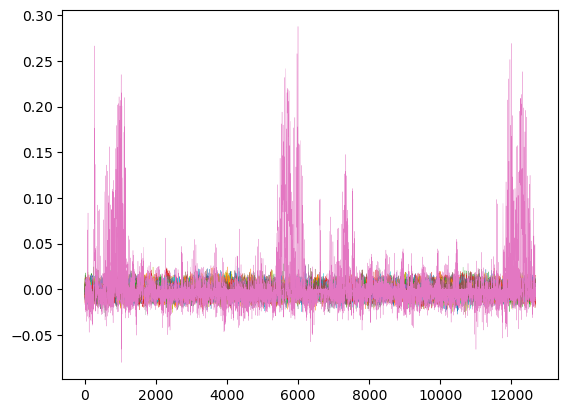

In [216]:
plt.plot(bootstrap_data.T,linewidth=0.2)
plt.plot(sub_data,linewidth=0.2)

In [229]:
p_vals=[]
for i,sub_d in enumerate(sub_data):
    bool_arr=bootstrap_data[:,i]>sub_d
    count = np.sum(bool_arr)
    p_vals.append(count/bootstrap_data.shape[0])

In [232]:
bh_corrected=false_discovery_control(p_vals, method='bh')

In [167]:
# an alternate valid way to get p-values
# from scipy.stats import norm

# p_vals2=[]
# for i,observed_statistic in enumerate(sub_data):
#     null_mean = np.mean(bootstrap_data[:,i])
#     null_std = np.std(bootstrap_data[:,i])
#     p_value = 1 - norm.cdf(observed_statistic, loc=null_mean, scale=null_std)
#     p_vals2.append(p_value)


## plot the FDR corrected

In [255]:
# put the grayordinates back where they belong
#parcel=['A4']

f=f'{temp_dir}feat-{feat}_sub-{sub}_ROI-{ROI}_PCA-{PCA}_delay-{delay}.npz'
data=np.load(f)

sub_data=data['stacked_r2s']
sub_data[bh_corrected > 0.05] = 0

data_to_plot=sub_data

parcel=parcels

all_brain=np.zeros(atlas_data.shape)

for i, ind in enumerate(atlas_indices_indices):
    all_brain[ind]=data_to_plot[i]
    
roi_indices,indices_,roi_names=nat_asd_utils.get_parcel_indices(atlas,parcel) #get indices of V1
roi_indices_indices = np.where(np.isin(atlas_data, roi_indices))[0]


plot_roi=np.zeros(atlas_data.shape)
for i, roi_ind in enumerate(roi_indices_indices):
    plot_roi[roi_ind]=all_brain[roi_ind]
roi_data=plot_roi[roi_indices_indices]

plotting.view_surf(hcp.mesh.inflated, hcp.cortex_data(plot_roi), 
    threshold=0.001,bg_map=hcp.mesh.sulc)

## plot the S_average

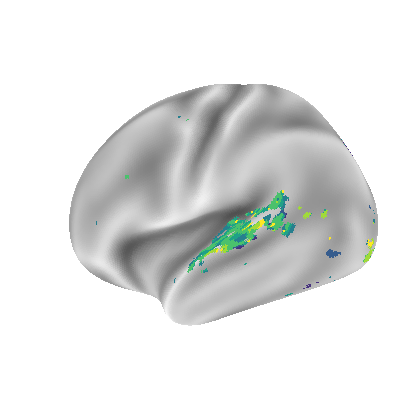

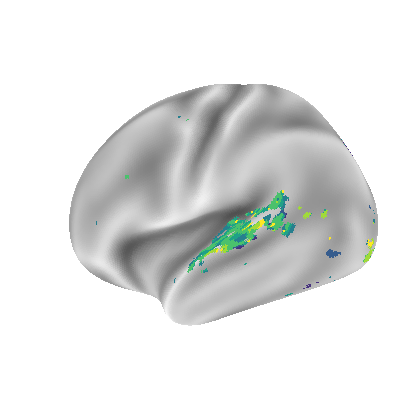

In [254]:
f=f'{temp_dir}feat-{feat}_sub-{sub}_ROI-{ROI}_PCA-{PCA}_delay-{delay}.npz'
data=np.load(f)

sub_data=np.argmax(data['S_average'],axis=1)

sub_data[bh_corrected > 0.05] = 0

data_to_plot=sub_data

parcel=parcels

all_brain=np.zeros(atlas_data.shape)

for i, ind in enumerate(atlas_indices_indices):
    all_brain[ind]=data_to_plot[i]
    
roi_indices,indices_,roi_names=nat_asd_utils.get_parcel_indices(atlas,parcel) #get indices of V1
roi_indices_indices = np.where(np.isin(atlas_data, roi_indices))[0]


plot_roi=np.zeros(atlas_data.shape)
for i, roi_ind in enumerate(roi_indices_indices):
    plot_roi[roi_ind]=all_brain[roi_ind]
roi_data=plot_roi[roi_indices_indices]

plotting.plot_surf(hcp.mesh.very_inflated, hcp.cortex_data(plot_roi), 
    threshold=0.001,bg_map=hcp.mesh.sulc,cmap='viridis',symmetric_cmap=False,avg_method='median')

## what roughly is the r2 value that is significant (since i don't have access to the cluster right now)

In [264]:
# put the grayordinates back where they belong
#parcel=['A4']

f=f'{temp_dir}feat-{feat}_sub-{sub}_ROI-{ROI}_PCA-{PCA}_delay-{delay}.npz'
data=np.load(f)

sub_data=data['stacked_r2s']
sub_data[bh_corrected < 0.05].min()

0.0030101071047327066

(array([107., 289., 282., 208., 143., 127.,  90.,  76.,  73.,  65.,  60.,
         46.,  43.,  37.,  51.,  34.,  34.,  34.,  40.,  29.,  23.,  29.,
         33.,  10.,  19.,   9.,  20.,   9.,  10.,  15.,  16.,  12.,   6.,
          8.,   8.,  10.,   8.,   9.,   1.,   3.,   2.,   3.,   1.,   1.,
          1.,   0.,   2.,   0.,   0.,   1.]),
 array([0.00301011, 0.00870635, 0.0144026 , 0.02009885, 0.0257951 ,
        0.03149135, 0.03718759, 0.04288384, 0.04858009, 0.05427634,
        0.05997258, 0.06566883, 0.07136508, 0.07706133, 0.08275758,
        0.08845382, 0.09415007, 0.09984632, 0.10554257, 0.11123881,
        0.11693506, 0.12263131, 0.12832756, 0.13402381, 0.13972005,
        0.1454163 , 0.15111255, 0.1568088 , 0.16250504, 0.16820129,
        0.17389754, 0.17959379, 0.18529004, 0.19098628, 0.19668253,
        0.20237878, 0.20807503, 0.21377127, 0.21946752, 0.22516377,
        0.23086002, 0.23655627, 0.24225251, 0.24794876, 0.25364501,
        0.25934126, 0.2650375 , 0.27073375, 0.

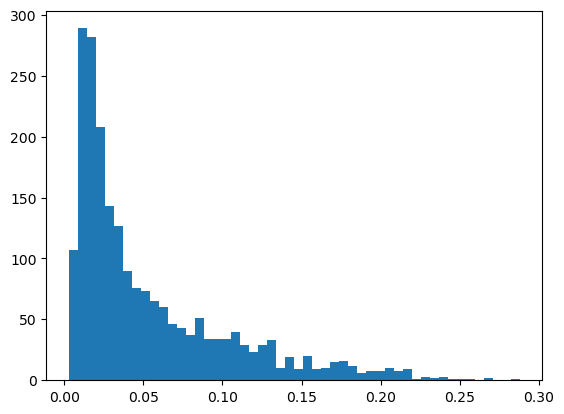

In [263]:
plt.hist(sub_data[bh_corrected < 0.05],bins=50)

## look at just the good subjects

In [30]:

parcels=['A1',
    'LBelt',
    'MBelt',
    'PBelt',
    'A4',
    'TA2',
    'A5']

feat='audio'
ROI='all'
PCA='1'
delay='6'
all_data=[]

metric='stacked_r2s'
temp_dir='/Users/jeff/Downloads/nat_asd_temp/pilot_results/'

files = glob.glob(f'{temp_dir}feat-{feat}_sub-*_ROI-{ROI}_PCA-{PCA}_delay-{delay}.npz')
subs = []
for path in files:
    start = path.find('sub-') + 4  # add 4 to exclude 'sub-' itself
    end = path.find('_ROI')
    isolated_string = path[start:end]
    subs.append(isolated_string)

# Determine the number of rows and columns for the subplots
thresh=0.05


# fig, axs = plt.subplots(num_rows, num_cols, figsize=(30,100))  # Adjust the size as needed
# fig.suptitle(f'feature: {feat}, PCA: {PCA}, delay TRs: {delay}, metric: {metric}')
all_data_list=[]
for i, f in enumerate(files):
    data=np.load(f)
    roi_data_all=get_data_by_roi(parcels,data,metric)
    roi_data_list=[]
    for ii, d in enumerate(roi_data_all):
        parcel_name = parcels[ii] 
        count = np.sum(np.array(d) > thresh)
        percentage = (count / len(d)) * 100
        roi_data_list.append(percentage)
    all_data_list.append(roi_data_list)


#fig.savefig(f'../plots/bar_feat-{feat}_PCA-{PCA}_delay-{delay}_metric-{metric}.png')


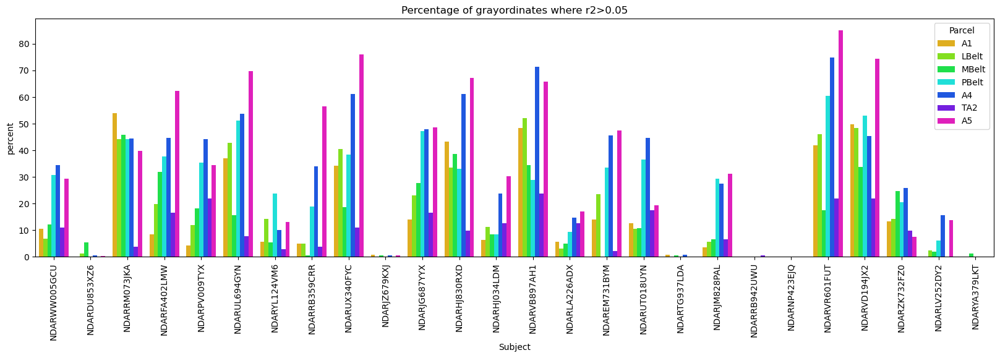

In [32]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

# Create a DataFrame
df = pd.DataFrame(np.asanyarray(all_data_list), index=subs, columns=parcels)

# Melt the DataFrame to make it suitable for seaborn
df_melted = df.reset_index().melt(id_vars='index')

# Create the bar plot
plt.figure(figsize=(20, 5))
sns.barplot(x='index', y='value', hue='variable', data=df_melted, palette='hsv')
plt.xlabel('Subject')
plt.ylabel('percent')
plt.title('Percentage of grayordinates where r2>0.05')
plt.xticks(rotation=90)

plt.legend(title='Parcel')
plt.show()


In [57]:
good_indices = [0,2,3,4,5,7,8,9,10,11,12,13,15,16,18,21,22]

# Create a new list with the values at the specified indices
good_subs = [subs[i] for i in good_indices]
good_subs

['NDARWW005GCU',
 'NDARRM073JKA',
 'NDARFA402LMW',
 'NDARPV009TYX',
 'NDARUL694GYN',
 'NDARRB359CRR',
 'NDARUX340FYC',
 'NDARJZ679KXJ',
 'NDARJG687YYX',
 'NDARHJ830RXD',
 'NDARHJ034LDM',
 'NDARVB897AH1',
 'NDAREM731BYM',
 'NDARUT018UYN',
 'NDARJM828PAL',
 'NDARVR601FUT',
 'NDARVD194JX2']

In [78]:
from scipy import stats
mode = stats.mode(sub_data_list, axis=0).mode
mode

array([2, 4, 3, ..., 5, 0, 5])

In [81]:
stats.mode( stats.mode(sub_data_list).mode ).mode

3

In [79]:
sub_data_list=[]
for sub in good_subs:
    f=f'{temp_dir}feat-{feat}_sub-{sub}_ROI-{ROI}_PCA-{PCA}_delay-{delay}.npz'
    data=np.load(f)
    
    sub_data=np.argmax(data['S_average'],axis=1)
    sub_data_list.append(sub_data)
sub_data_list=np.asanyarray(sub_data_list)



# Assuming 'arr' is your numpy array
arr = np.array([[1, 2, 3], [4, 2, 6], [1, 2, 9]])

# Use scipy's stats.mode function


#data_to_plot=np.mean(sub_data_list,axis=0)
data_to_plot=stats.mode(sub_data_list, axis=0).mode

parcel=parcels

all_brain=np.zeros(atlas_data.shape)

for i, ind in enumerate(atlas_indices_indices):
    all_brain[ind]=data_to_plot[i]
    
roi_indices,indices_,roi_names=nat_asd_utils.get_parcel_indices(atlas,parcel) #get indices of V1
roi_indices_indices = np.where(np.isin(atlas_data, roi_indices))[0]


plot_roi=np.zeros(atlas_data.shape)
for i, roi_ind in enumerate(roi_indices_indices):
    plot_roi[roi_ind]=all_brain[roi_ind]
roi_data=plot_roi[roi_indices_indices]

plotting.view_surf(hcp.mesh.very_inflated, hcp.cortex_data(plot_roi), 
    threshold=0.001,bg_map=hcp.mesh.sulc,cmap='viridis',symmetric_cmap=False)

In [ ]:
#plot each subject A1, A4, TA2, A5
#count each subject - how many voxels are above 0.05
#identify the best subjects
#redo the above plots with just them aggregated across. Stop there!